**1 Environment**

In [ ]:
# One-time installs (Colab):
# !pip install -U diffusers transformers accelerate safetensors torch


**2 Load SDXL**

In [ ]:
import torch, time, os, re, pandas as pd
from diffusers import StableDiffusionXLPipeline

SDXL_ID = "stabilityai/stable-diffusion-xl-base-1.0"
dtype = torch.float16 if torch.cuda.is_available() else torch.float32

pipe = StableDiffusionXLPipeline.from_pretrained(SDXL_ID, torch_dtype=dtype)
if torch.cuda.is_available():
    pipe = pipe.to("cuda")
pipe.enable_attention_slicing()
pipe.enable_vae_slicing()


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

text_encoder_2/model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/10.3G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

vae_1_0/diffusion_pytorch_model.safetens(…):   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


**3 Prompts**

In [ ]:
prompts = [
    "A golden retriever puppy sitting in a field of flowers, sunny afternoon",
    "A cozy wooden cabin in snowy mountains at sunset, warm lights in the windows",
]
neg = "blurry, low quality, text, watermark"


**4 Generate images + log latency**

  0%|          | 0/28 [00:00<?, ?it/s]


Saved sdxl_outputs/01_A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny.png  (19.7s)
Prompt: A golden retriever puppy sitting in a field of flowers, sunny afternoon


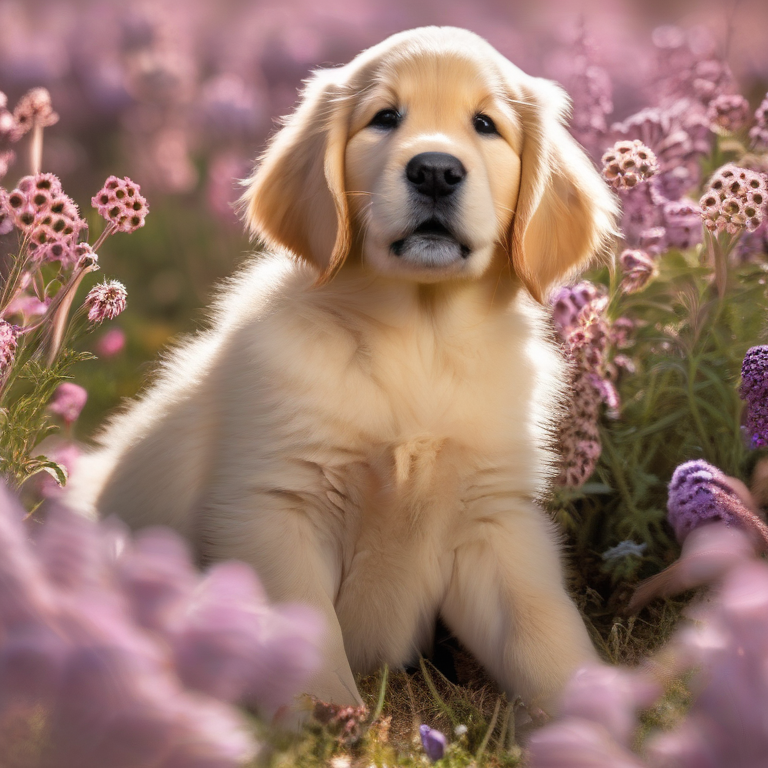

  0%|          | 0/28 [00:00<?, ?it/s]


Saved sdxl_outputs/02_A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights.png  (17.1s)
Prompt: A cozy wooden cabin in snowy mountains at sunset, warm lights in the windows


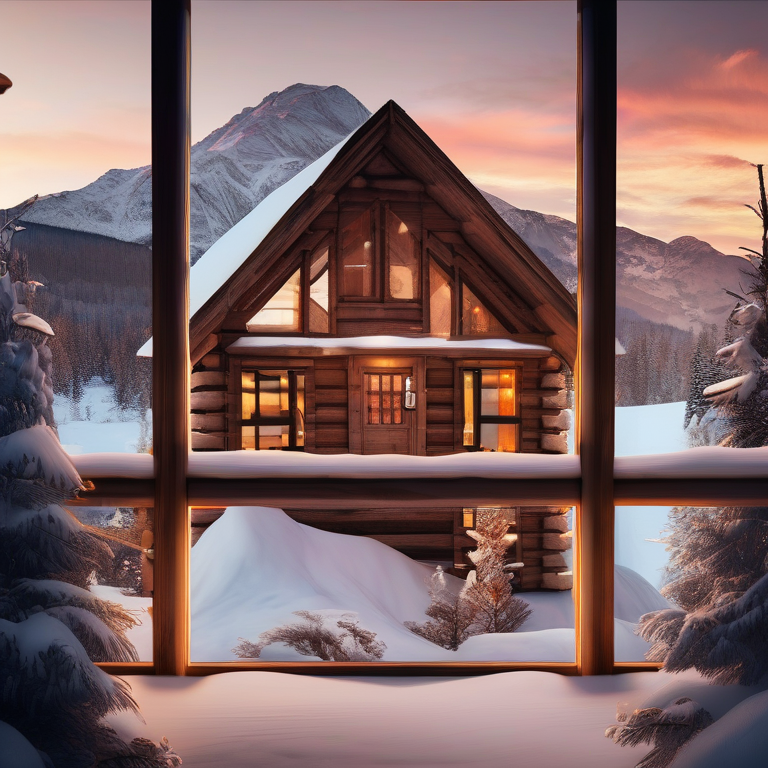


Log saved -> sdxl_generations.csv


In [ ]:
# === Save AND DISPLAY SDXL images ===
from IPython.display import display  # <-- for inline output

# fallback negative prompt if you didn't define `neg` earlier
neg = globals().get("neg", "blurry, low quality, text, watermark")

def _safe(s):
    return re.sub(r"[^a-zA-Z0-9\- ]","",s)[:60].strip().replace(" ","_") or "image"

os.makedirs("sdxl_outputs", exist_ok=True)

rows = []
gen = torch.Generator(device=pipe.device).manual_seed(42)  # reproducible

for i, p in enumerate(prompts, 1):
    t0 = time.time()
    res = pipe(
        prompt=p,
        negative_prompt=neg,
        num_inference_steps=28,
        guidance_scale=5.5,
        height=768,
        width=768,
        generator=gen
    )
    dt = time.time() - t0
    img = res.images[0]

    # save
    path = f"sdxl_outputs/{i:02d}_{_safe(p)}.png"
    img.save(path)

    # inline display
    print(f"\nSaved {path}  ({dt:.1f}s)")
    print(f"Prompt: {p}")
    display(img)

    rows.append({"prompt": p, "image_path": path, "latency_s": dt})

# CSV log for your report
pd.DataFrame(rows).to_csv("sdxl_generations.csv", index=False)
print("\nLog saved -> sdxl_generations.csv")


In [ ]:
import os, re, time, math, torch, pandas as pd
from IPython.display import display
from PIL import Image
from diffusers import StableDiffusionXLPipeline, EulerDiscreteScheduler, DPMSolverMultistepScheduler

# Reuse existing pipe if present; otherwise load.
if "pipe" not in globals():
    SDXL_ID = "stabilityai/stable-diffusion-xl-base-1.0"
    dtype = torch.float16 if torch.cuda.is_available() else torch.float32
    pipe = StableDiffusionXLPipeline.from_pretrained(SDXL_ID, torch_dtype=dtype)
    if torch.cuda.is_available():
        pipe = pipe.to("cuda")
        try: pipe.enable_xformers_memory_efficient_attention()
        except Exception: pass
    pipe.enable_attention_slicing()
    pipe.enable_vae_slicing()
    pipe.set_progress_bar_config(disable=True)

os.makedirs("sdxl_bench", exist_ok=True)

def _safe(s):
    return re.sub(r"[^a-zA-Z0-9\- ]","",s)[:60].strip().replace(" ","_") or "image"

SCHEDULERS = {
    "euler": lambda p: EulerDiscreteScheduler.from_config(p.scheduler.config),
    "dpm":   lambda p: DPMSolverMultistepScheduler.from_config(p.scheduler.config),
}

def set_scheduler(pipe, name):
    pipe.scheduler = SCHEDULERS[name](pipe)

def run_sdxl(prompt, steps, h, w, guidance, scheduler_name, seed=42, neg="blurry, low quality, text, watermark"):
    # scheduler swap
    set_scheduler(pipe, scheduler_name)
    # generator
    gen = torch.Generator(device=pipe.device).manual_seed(seed) if seed is not None else None

    t0 = time.time()
    out = pipe(
        prompt=prompt,
        negative_prompt=neg,
        num_inference_steps=steps,
        guidance_scale=guidance,
        height=h, width=w,
        generator=gen,
    )
    dt = time.time() - t0
    img = out.images[0]
    fname = f"{_safe(prompt)}__{scheduler_name}_{steps}st_{h}x{w}_cfg{guidance}_{seed or 'rnd'}.png"
    fpath = os.path.join("sdxl_bench", fname)
    img.save(fpath)
    return img, dt, fpath


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

text_encoder_2/model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/10.3G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

vae_1_0/diffusion_pytorch_model.safetens(…):   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


Saved: sdxl_bench/A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny__euler_16st_512x512_cfg3.0_42.png  (5.7s)


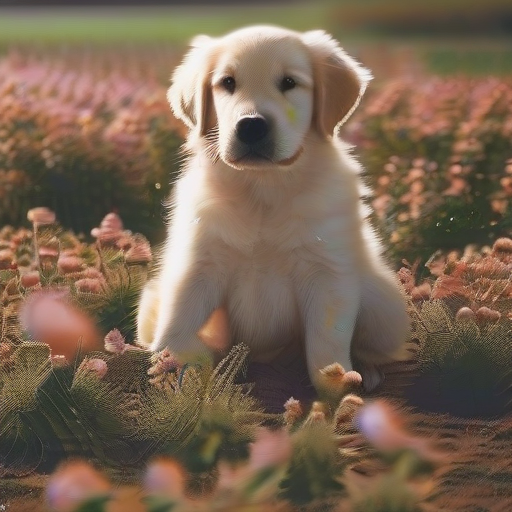

Saved: sdxl_bench/A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny__dpm_16st_512x512_cfg3.0_42.png  (4.1s)


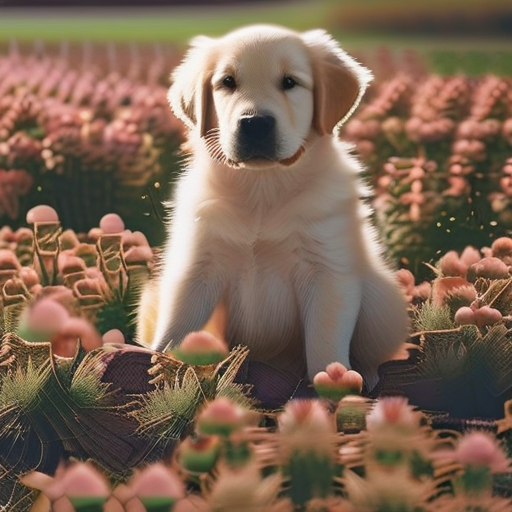

Saved: sdxl_bench/A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny__euler_16st_512x512_cfg5.5_42.png  (3.9s)


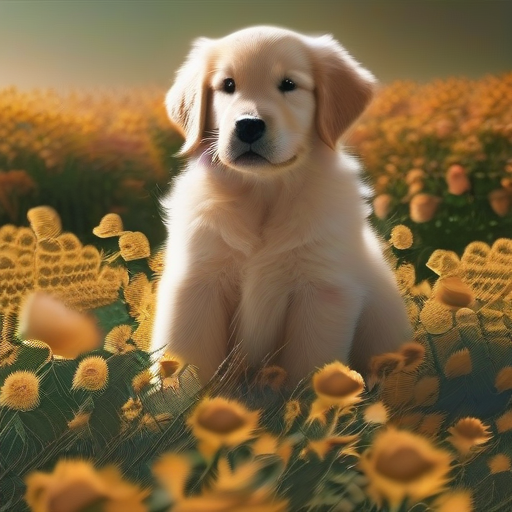

Saved: sdxl_bench/A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny__dpm_16st_512x512_cfg5.5_42.png  (3.9s)


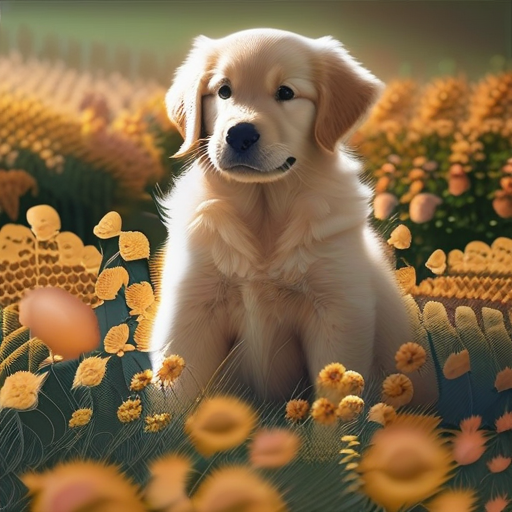

Saved: sdxl_bench/A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny__euler_28st_512x512_cfg3.0_42.png  (7.1s)


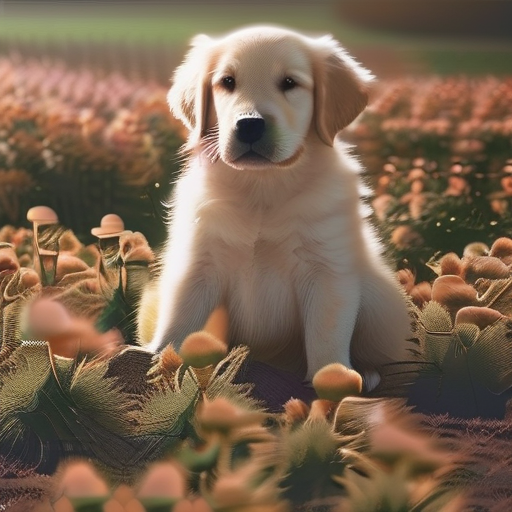

Saved: sdxl_bench/A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny__dpm_28st_512x512_cfg3.0_42.png  (6.6s)


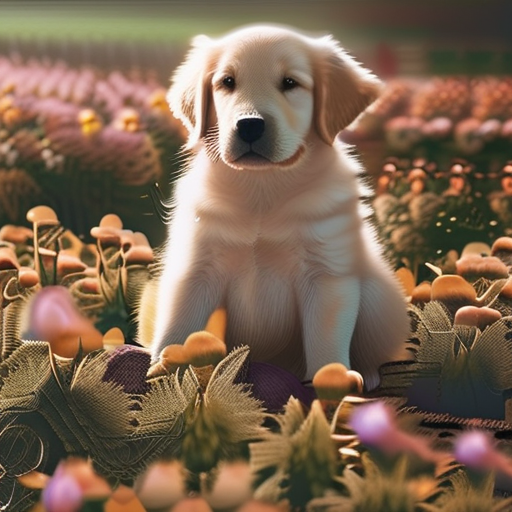

Saved: sdxl_bench/A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny__euler_28st_512x512_cfg5.5_42.png  (7.0s)


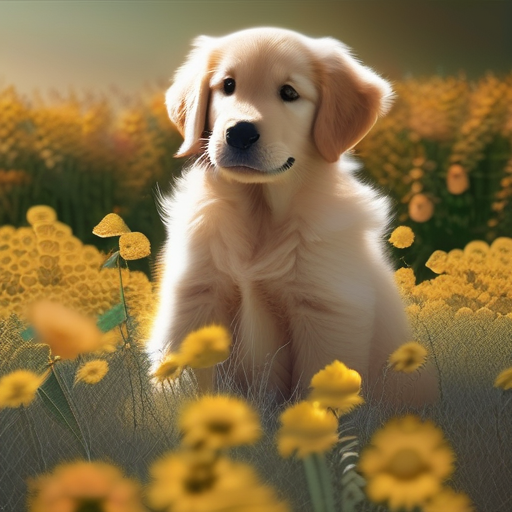

Saved: sdxl_bench/A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny__dpm_28st_512x512_cfg5.5_42.png  (6.8s)


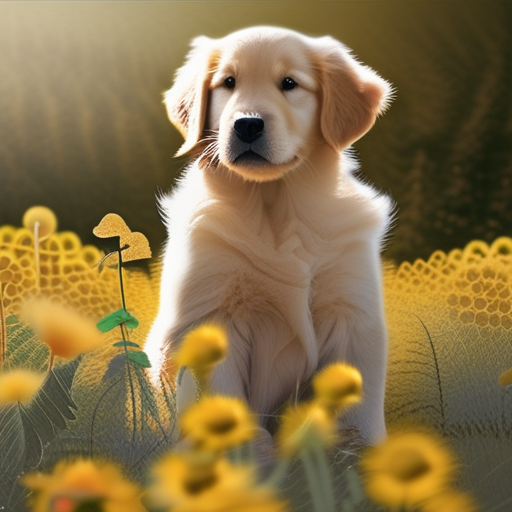

Saved: sdxl_bench/A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny__euler_16st_768x768_cfg3.0_42.png  (10.5s)


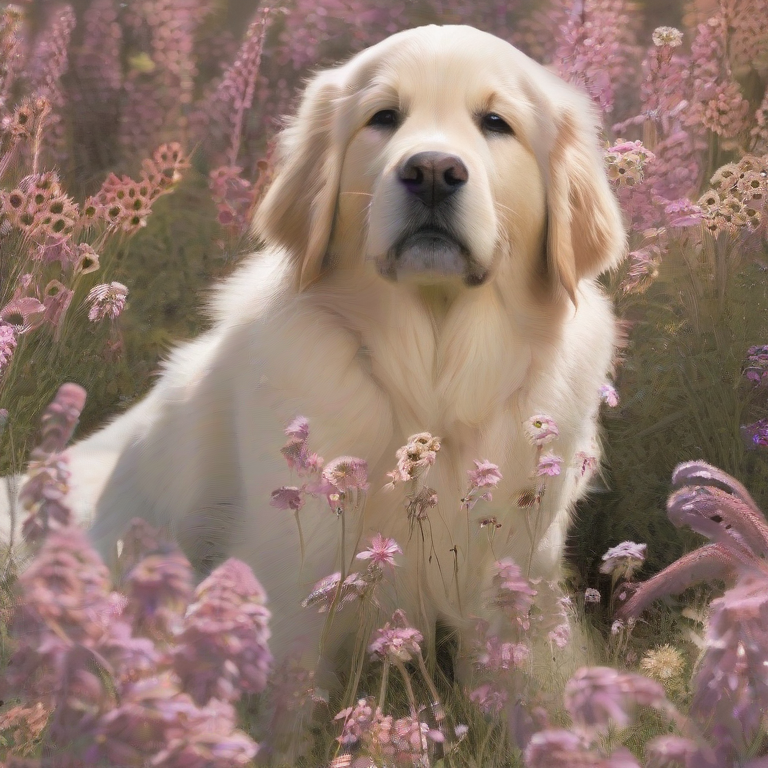

Saved: sdxl_bench/A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny__dpm_16st_768x768_cfg3.0_42.png  (10.5s)


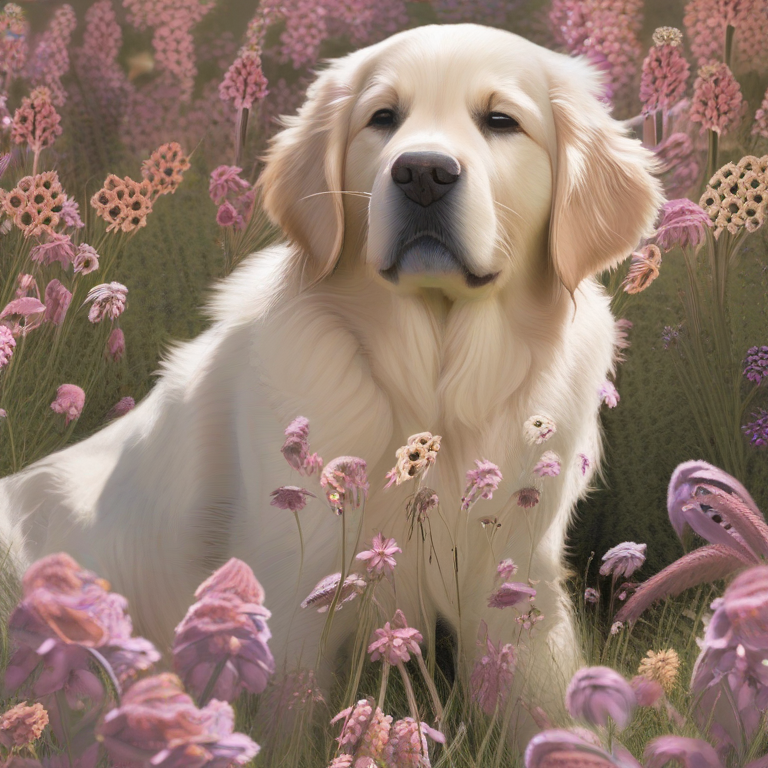

Saved: sdxl_bench/A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny__euler_16st_768x768_cfg5.5_42.png  (10.3s)


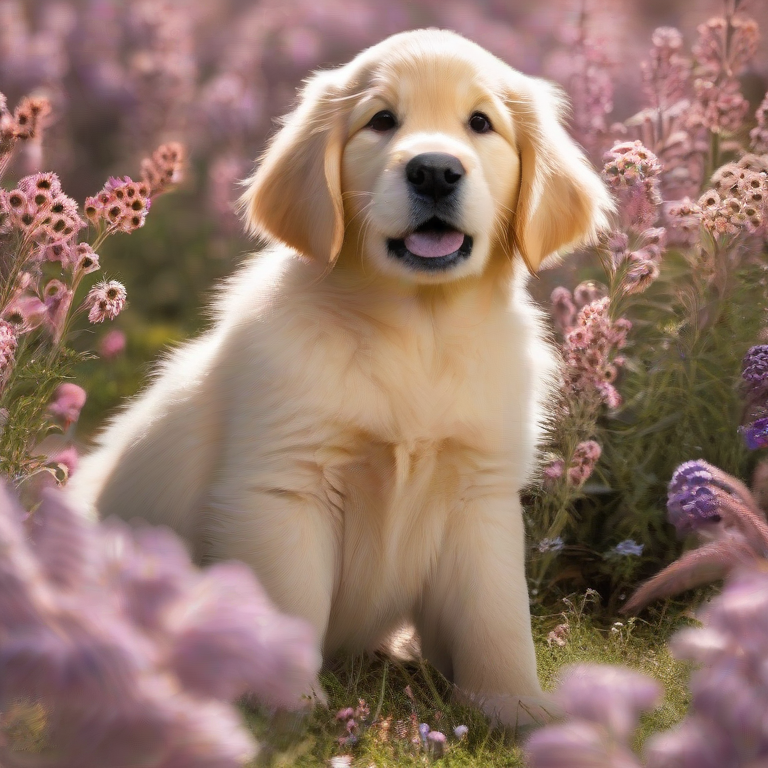

Saved: sdxl_bench/A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny__dpm_16st_768x768_cfg5.5_42.png  (10.2s)


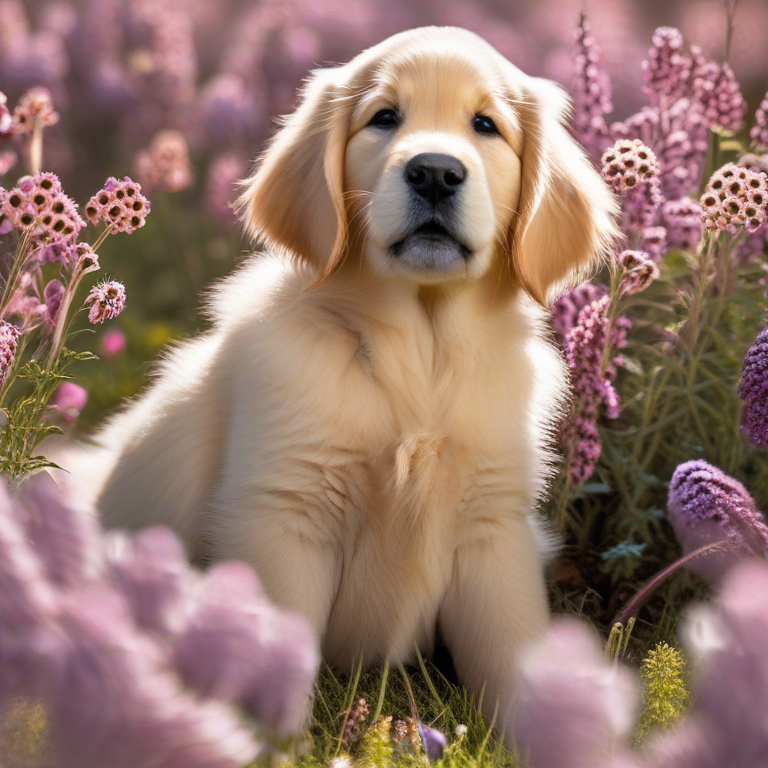

Saved: sdxl_bench/A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny__euler_28st_768x768_cfg3.0_42.png  (16.8s)


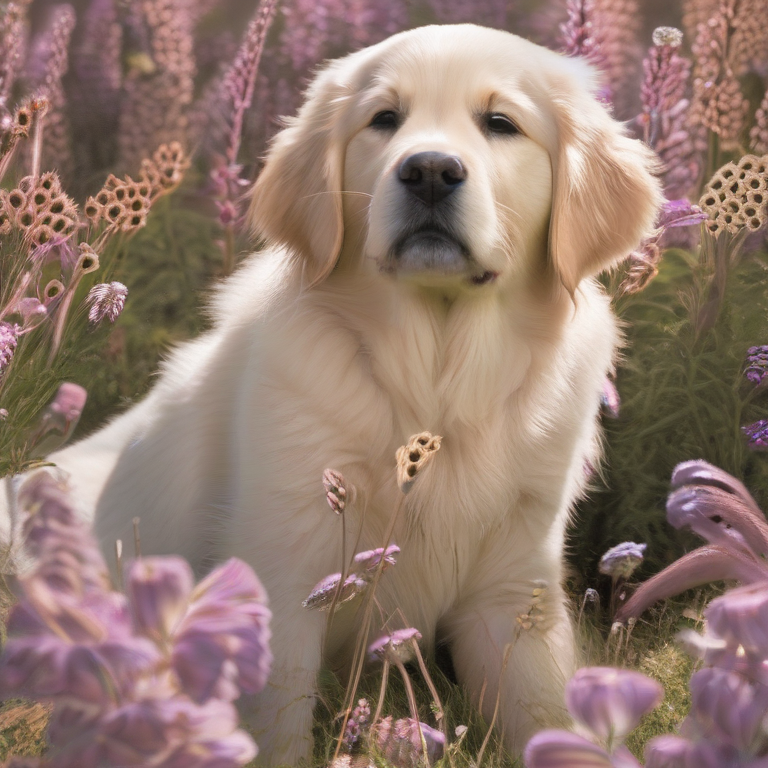

Saved: sdxl_bench/A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny__dpm_28st_768x768_cfg3.0_42.png  (16.9s)


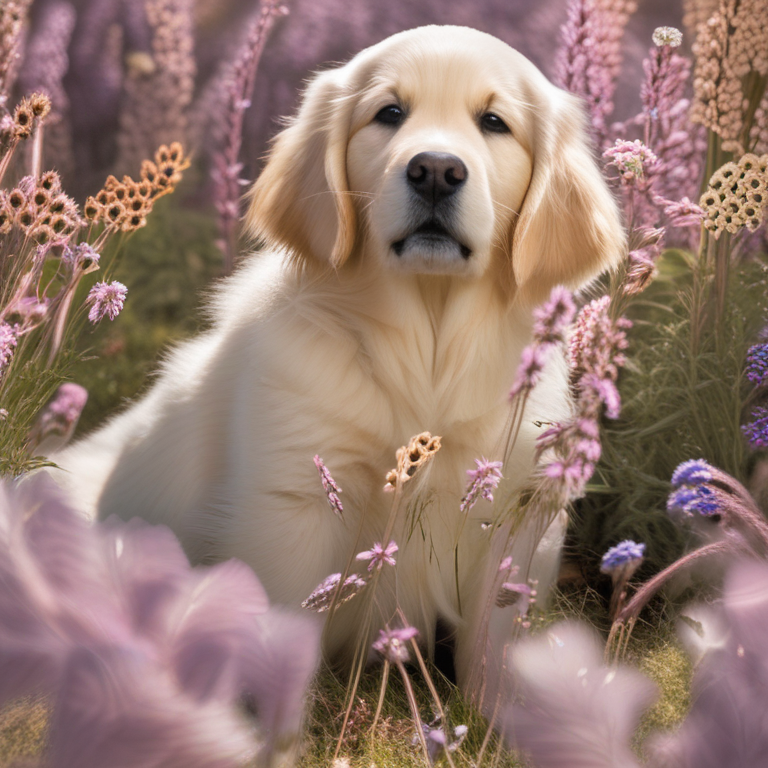

Saved: sdxl_bench/A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny__euler_28st_768x768_cfg5.5_42.png  (17.0s)


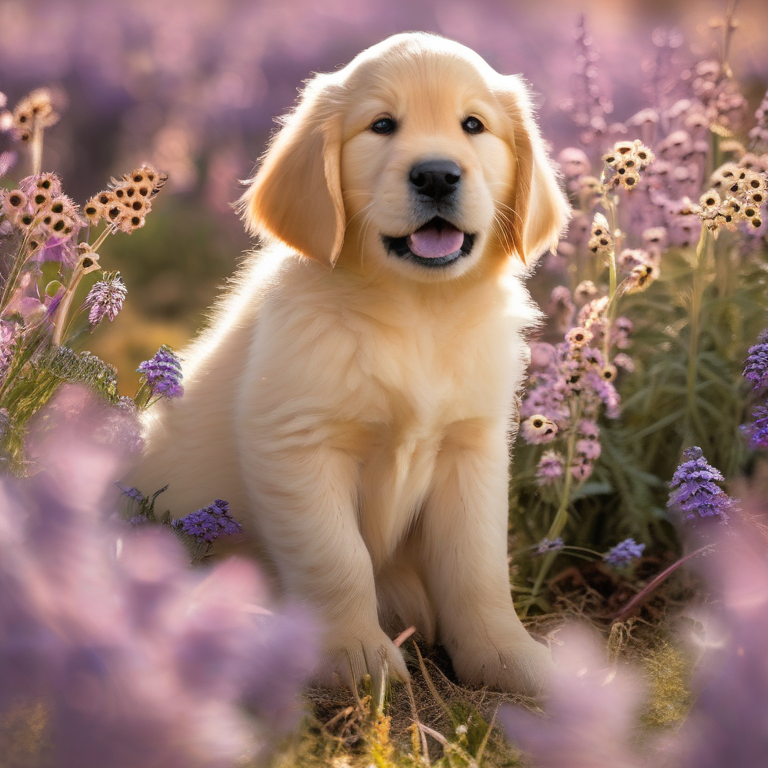

Saved: sdxl_bench/A_golden_retriever_puppy_sitting_in_a_field_of_flowers_sunny__dpm_28st_768x768_cfg5.5_42.png  (17.1s)


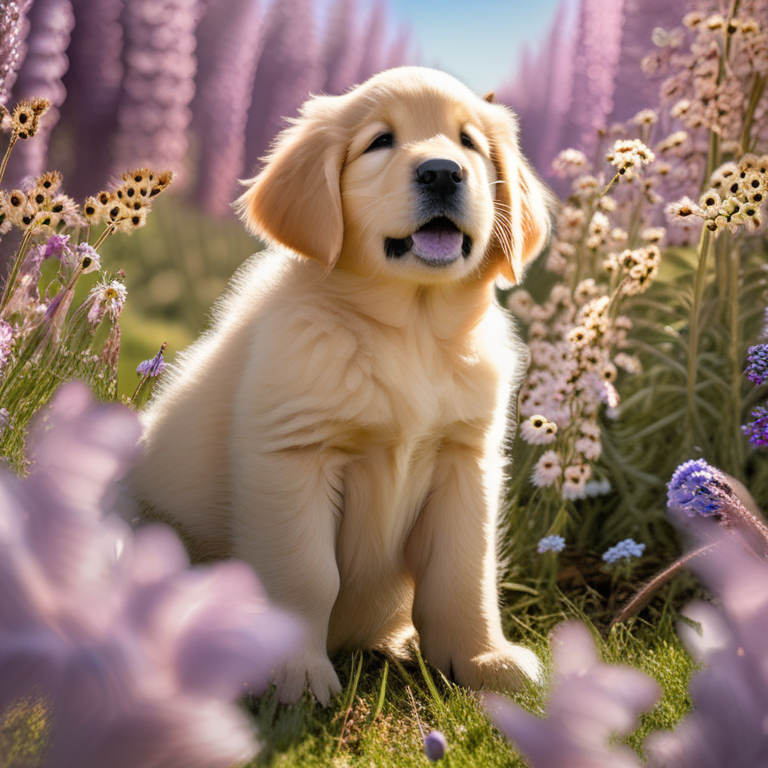

Saved: sdxl_bench/A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights__euler_16st_512x512_cfg3.0_42.png  (4.3s)


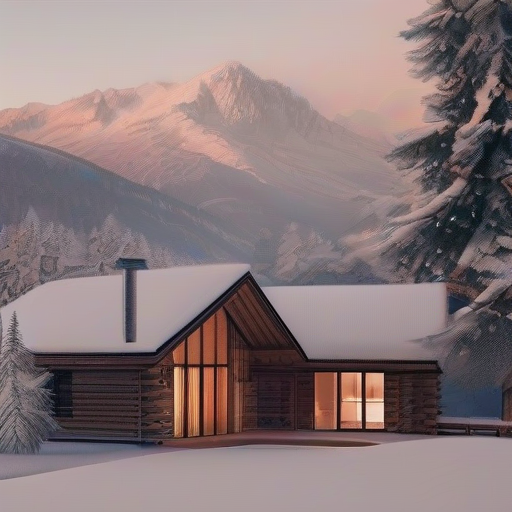

Saved: sdxl_bench/A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights__dpm_16st_512x512_cfg3.0_42.png  (4.2s)


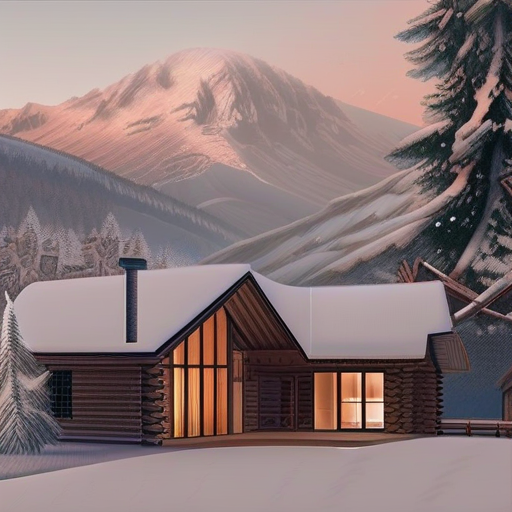

Saved: sdxl_bench/A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights__euler_16st_512x512_cfg5.5_42.png  (4.3s)


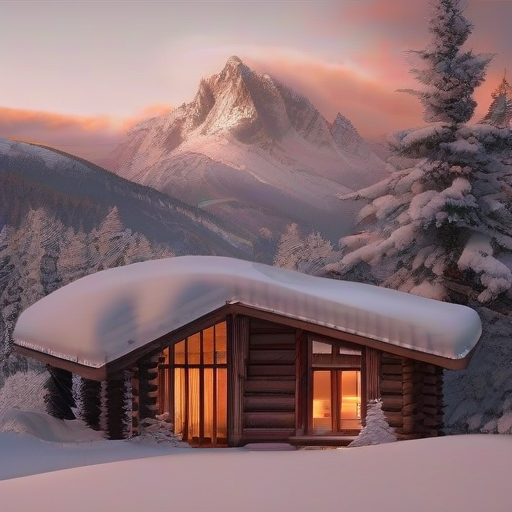

Saved: sdxl_bench/A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights__dpm_16st_512x512_cfg5.5_42.png  (4.1s)


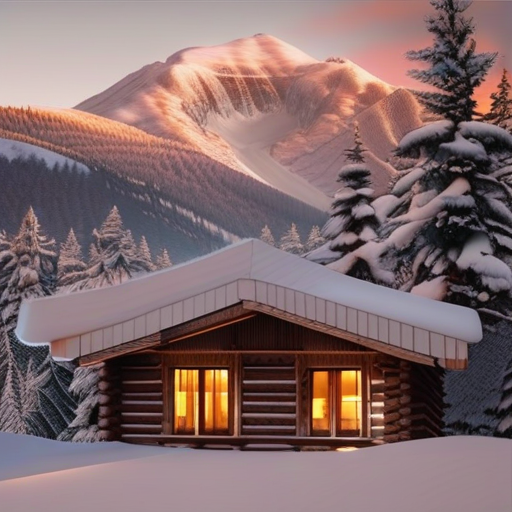

Saved: sdxl_bench/A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights__euler_28st_512x512_cfg3.0_42.png  (6.9s)


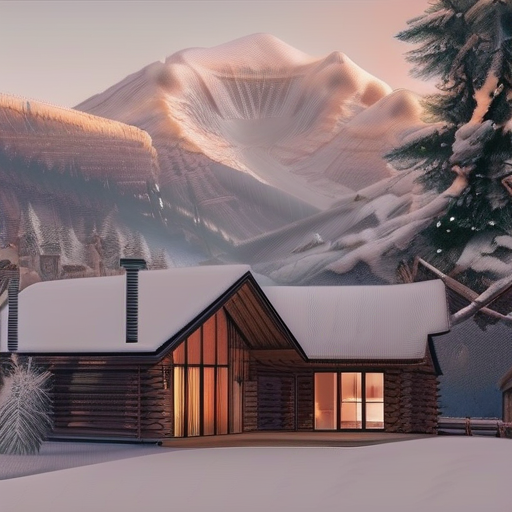

Saved: sdxl_bench/A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights__dpm_28st_512x512_cfg3.0_42.png  (6.8s)


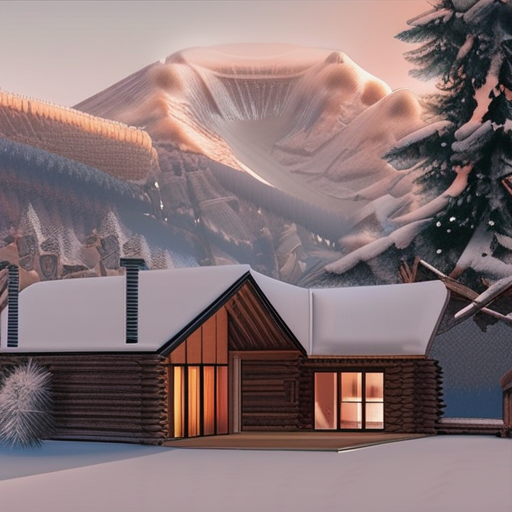

Saved: sdxl_bench/A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights__euler_28st_512x512_cfg5.5_42.png  (7.0s)


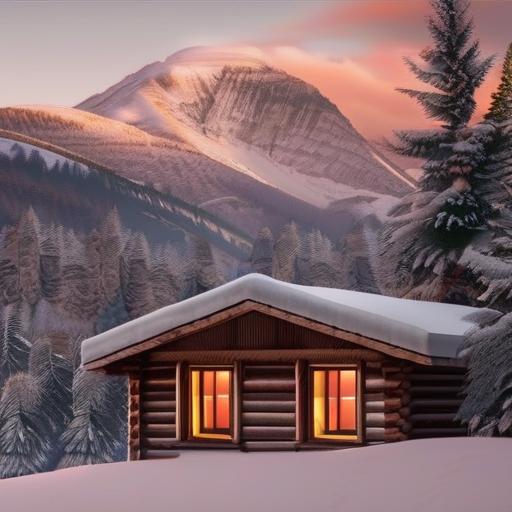

Saved: sdxl_bench/A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights__dpm_28st_512x512_cfg5.5_42.png  (6.8s)


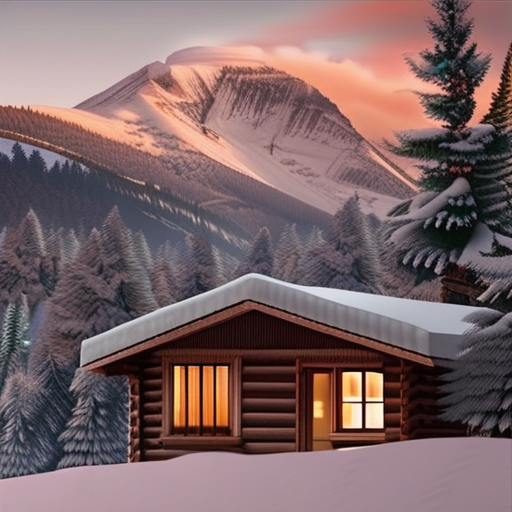

Saved: sdxl_bench/A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights__euler_16st_768x768_cfg3.0_42.png  (10.1s)


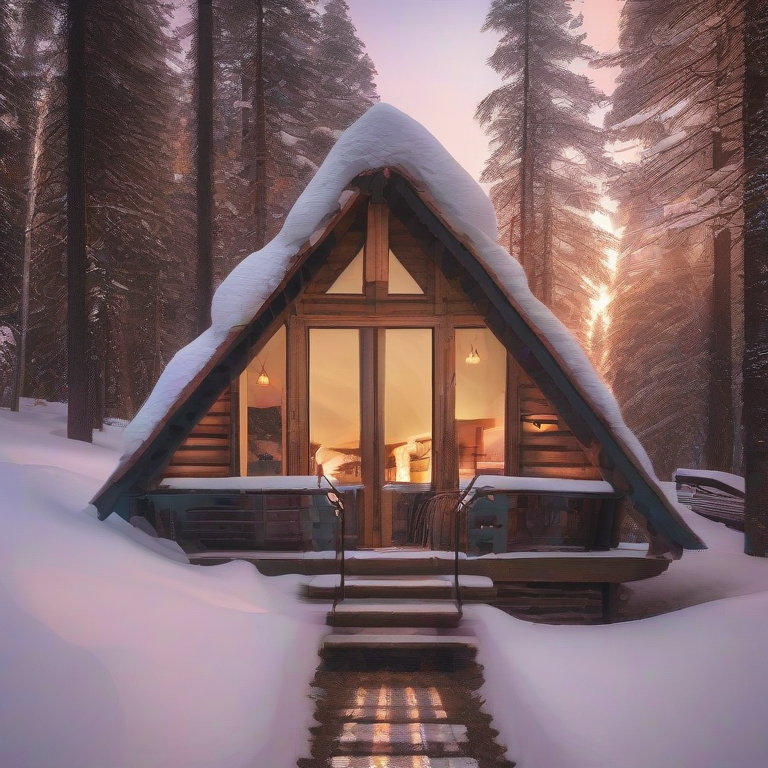

Saved: sdxl_bench/A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights__dpm_16st_768x768_cfg3.0_42.png  (10.2s)


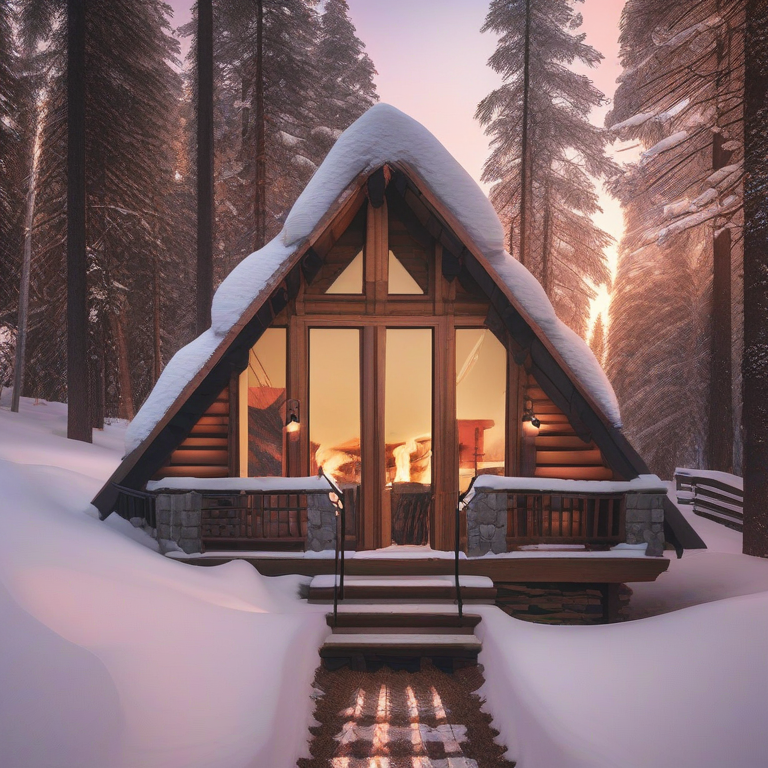

Saved: sdxl_bench/A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights__euler_16st_768x768_cfg5.5_42.png  (10.2s)


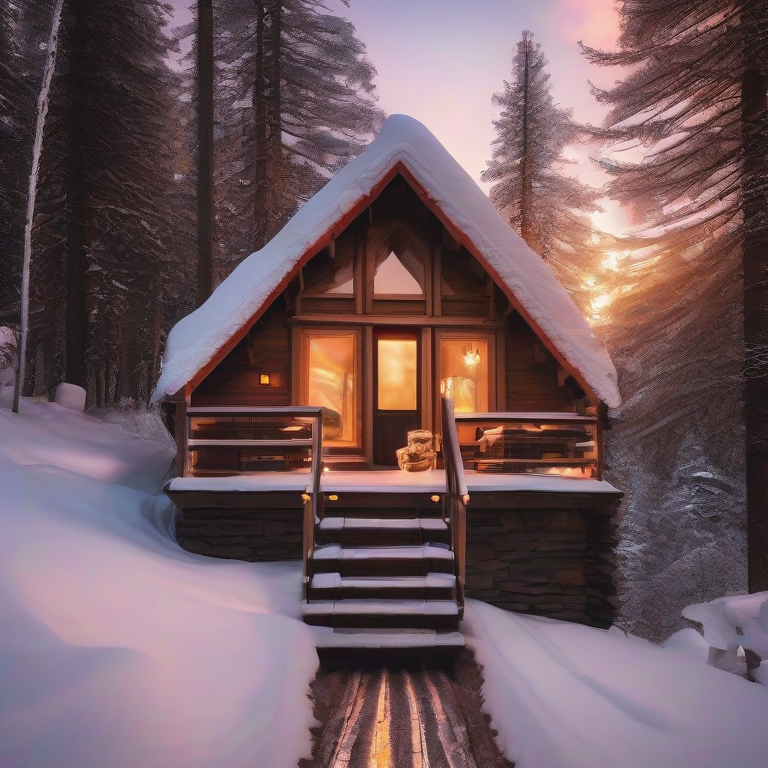

Saved: sdxl_bench/A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights__dpm_16st_768x768_cfg5.5_42.png  (10.2s)


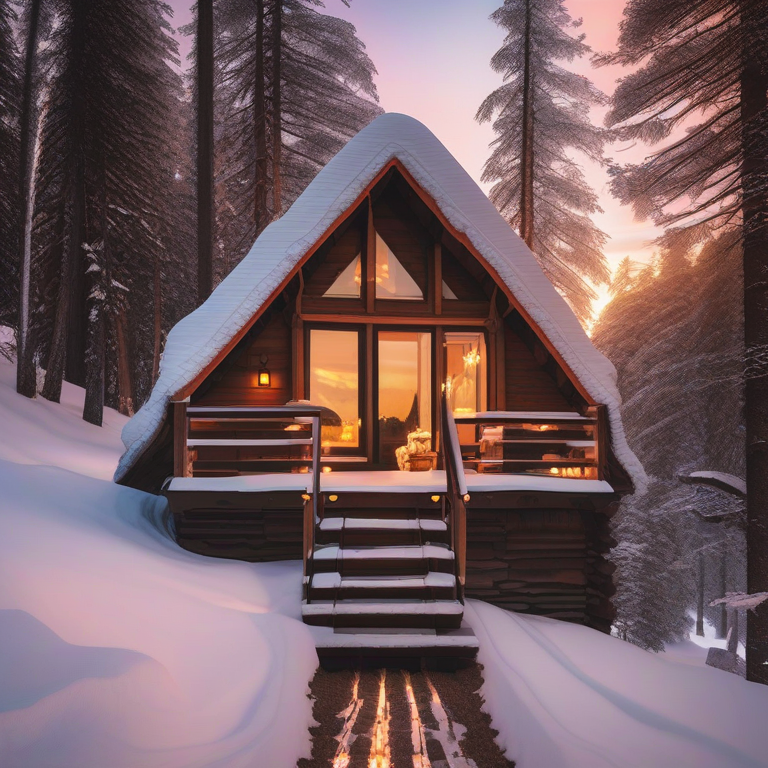

Saved: sdxl_bench/A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights__euler_28st_768x768_cfg3.0_42.png  (17.0s)


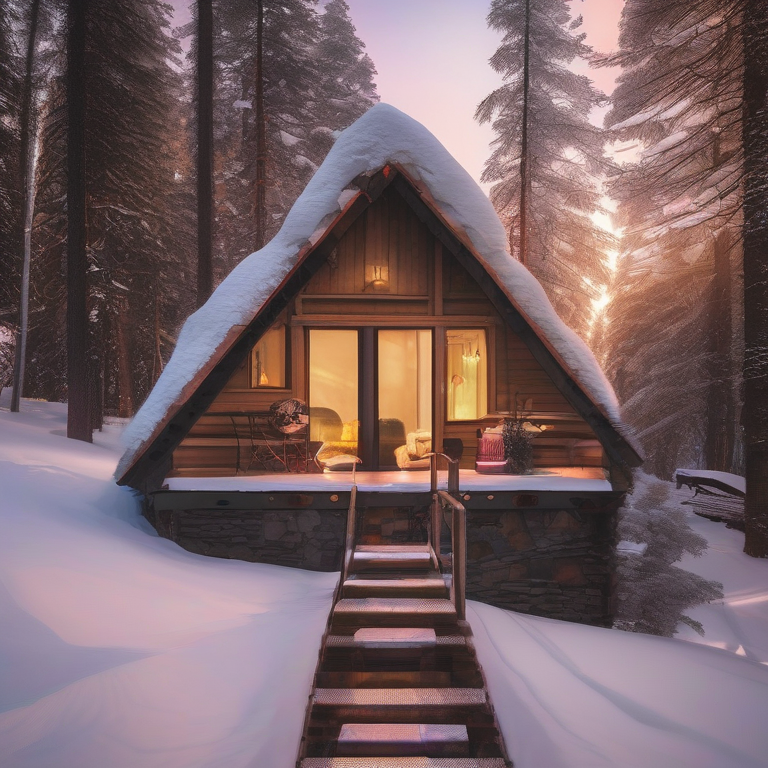

Saved: sdxl_bench/A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights__dpm_28st_768x768_cfg3.0_42.png  (17.0s)


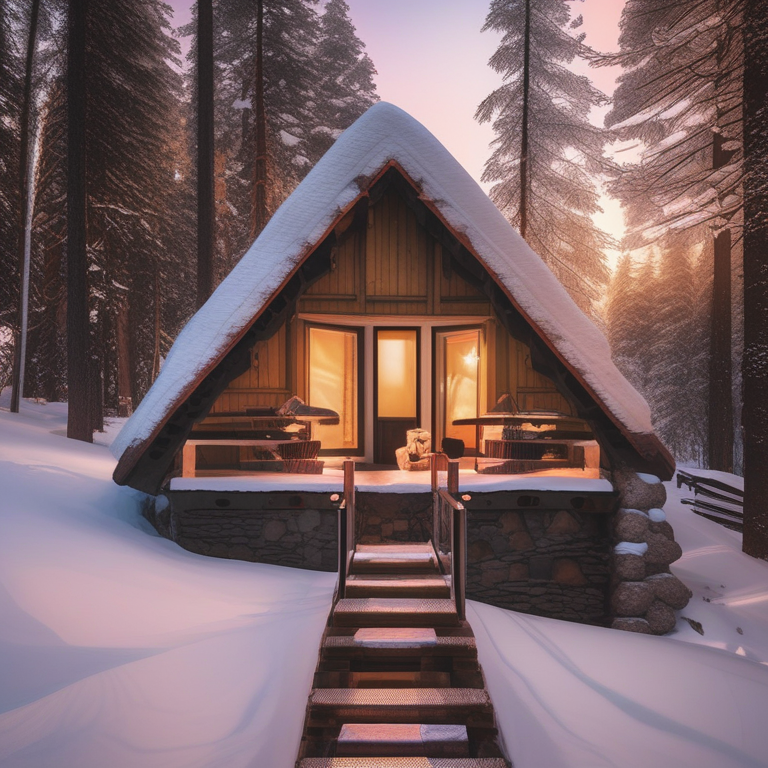

Saved: sdxl_bench/A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights__euler_28st_768x768_cfg5.5_42.png  (17.0s)


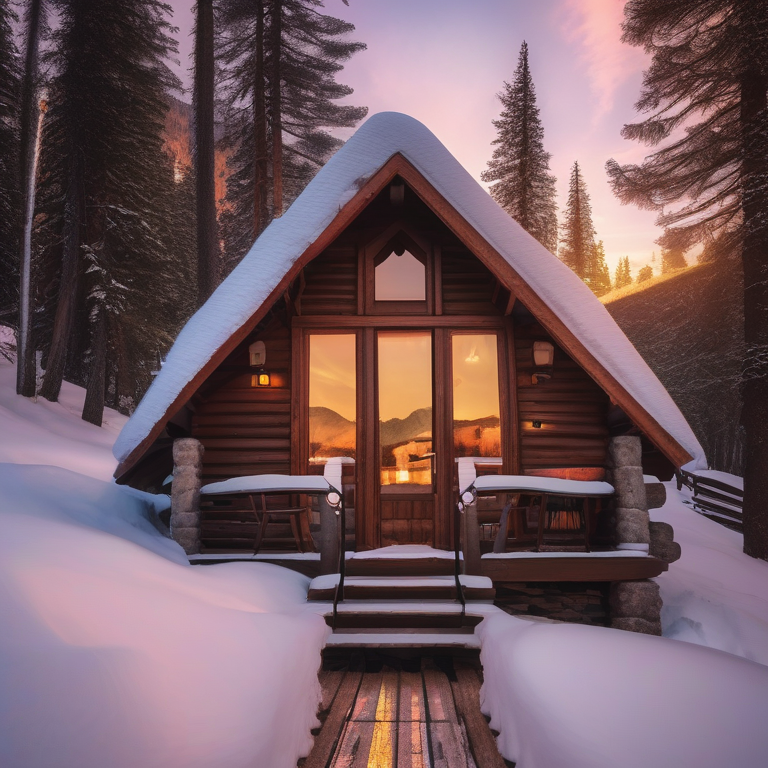

Saved: sdxl_bench/A_cozy_wooden_cabin_in_snowy_mountains_at_sunset_warm_lights__dpm_28st_768x768_cfg5.5_42.png  (17.0s)


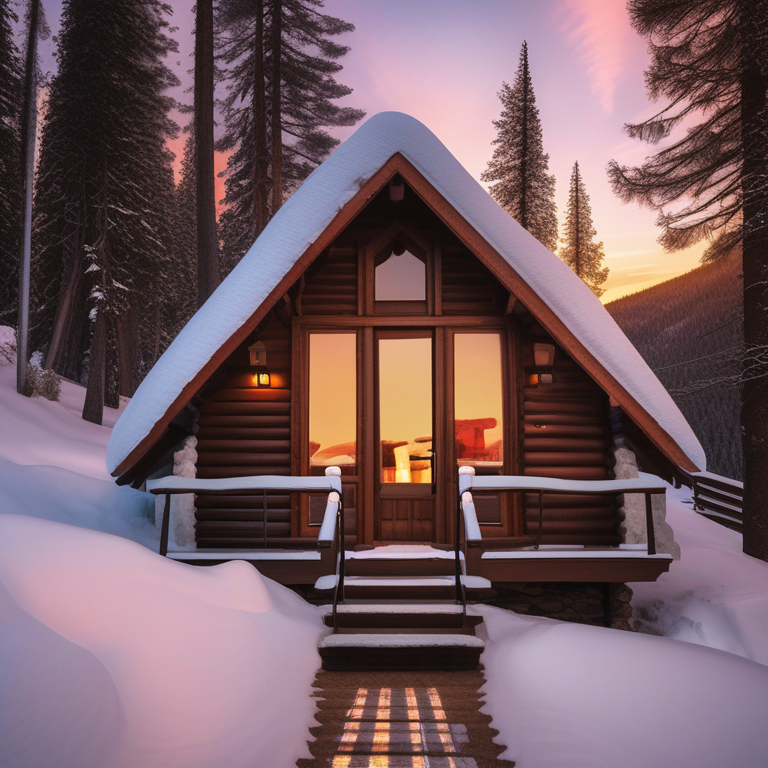

In [6]:
prompts = [
    "A golden retriever puppy sitting in a field of flowers, sunny afternoon.",
    "A cozy wooden cabin in snowy mountains at sunset, warm lights in the windows.",
]

steps_list     = [16, 28]         # add 40/50 later if you want
sizes          = [(512,512), (768,768)]  # add (1024,1024) if your GPU allows
guidance_list  = [3.0, 5.5]
schedulers     = ["euler", "dpm"]
seeds          = [42]             # add None for random variation

results = []
for prompt in prompts:
    for (h,w) in sizes:
        for steps in steps_list:
            for cfg in guidance_list:
                for sch in schedulers:
                    for seed in seeds:
                        try:
                            img, latency, path = run_sdxl(prompt, steps, h, w, cfg, sch, seed)
                            print(f"Saved: {path}  ({latency:.1f}s)")
                            display(img)  # inline
                            results.append({
                                "prompt": prompt,
                                "height": h, "width": w,
                                "steps": steps, "guidance": cfg,
                                "scheduler": sch, "seed": seed,
                                "latency_s": latency,
                                "image_path": path,
                            })
                        except torch.cuda.OutOfMemoryError:
                            if torch.cuda.is_available():
                                torch.cuda.empty_cache()
                            print(f"OOM @ {w}x{h}, {steps} steps, cfg {cfg}, {sch}. Skipping.")
                        except Exception as e:
                            print("Error:", e)


In [7]:
import pandas as pd

df = pd.DataFrame(results)
csv_path = "sdxl_benchmark.csv"
df.to_csv(csv_path, index=False)
print("Saved:", csv_path)

# Fast “best of” tables you can paste in the PDF
print("\n=== Fastest by prompt ===")
print(df.sort_values("latency_s").groupby("prompt").head(1)
      [["prompt","height","width","steps","guidance","scheduler","latency_s","image_path"]])

print("\n=== Highest steps & size (quality-biased) by prompt ===")
df["quality_bias"] = df["steps"] * (df["height"]/512)  # crude proxy
print(df.sort_values("quality_bias", ascending=False)
      .groupby("prompt").head(1)
      [["prompt","height","width","steps","guidance","scheduler","latency_s","image_path"]])

Saved: sdxl_benchmark.csv

=== Fastest by prompt ===
                                               prompt  height  width  steps  \
2   A golden retriever puppy sitting in a field of...     512    512     16   
19  A cozy wooden cabin in snowy mountains at suns...     512    512     16   

    guidance scheduler  latency_s  \
2        5.5     euler   3.894388   
19       5.5       dpm   4.126153   

                                           image_path  
2   sdxl_bench/A_golden_retriever_puppy_sitting_in...  
19  sdxl_bench/A_cozy_wooden_cabin_in_snowy_mounta...  

=== Highest steps & size (quality-biased) by prompt ===
                                               prompt  height  width  steps  \
12  A golden retriever puppy sitting in a field of...     768    768     28   
31  A cozy wooden cabin in snowy mountains at suns...     768    768     28   

    guidance scheduler  latency_s  \
12       3.0     euler  16.810893   
31       5.5       dpm  17.040551   

                      